In [1]:
import pycaret

C:\Users\91704\.conda\envs\pycaret\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
C:\Users\91704\.conda\envs\pycaret\lib\site-packages\numpy\.libs\libopenblas.GK7GX5KEQ4F6UYO3P26ULGBQYHGQO7J4.gfortran-win_amd64.dll
C:\Users\91704\.conda\envs\pycaret\lib\site-packages\numpy\.libs\libopenblas.WCDJNK7YVMPZQ2ME2ZZHJJRJ3JIKNDB7.gfortran-win_amd64.dll
  warnings.warn("loaded more than 1 DLL from .libs:"


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [3]:
df = pd.read_csv('clinvar_conflicting.csv')

C:\Users\91704\AppData\Local\Temp\ipykernel_14296\4017009474.py:1: DtypeWarning: Columns (0,38,40) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('clinvar_conflicting.csv')


In [4]:
df.head()

,CHROM,POS,REF,ALT,AF_ESP,AF_EXAC,AF_TGP,CLNDISDB,CLNDISDBINCL,CLNDN,...,SIFT,PolyPhen,MOTIF_NAME,MOTIF_POS,HIGH_INF_POS,MOTIF_SCORE_CHANGE,LoFtool,CADD_PHRED,CADD_RAW,BLOSUM62
0,1,1168180,G,C,0.0771,0.10020,0.1066,MedGen:CN169374,NaN,not_specified,...,tolerated,benign,NaN,NaN,NaN,NaN,NaN,1.053,-0.208682,2.0
1,1,1470752,G,A,0.0000,0.00000,0.0000,"MedGen:C1843891,OMIM:607454,Orphanet:ORPHA9877...",NaN,Spinocerebellar_ataxia_21|not_provided,...,deleterious_low_confidence,benign,NaN,NaN,NaN,NaN,NaN,31.000,6.517838,-3.0
2,1,1737942,A,G,0.0000,0.00001,0.0000,"Human_Phenotype_Ontology:HP:0000486,MedGen:C00...",NaN,Strabismus|Nystagmus|Hypothyroidism|Intellectu...,...,deleterious,probably_damaging,NaN,NaN,NaN,NaN,NaN,28.100,6.061752,-1.0
3,1,2160305,G,A,0.0000,0.00000,0.0000,"MedGen:C1321551,OMIM:182212,SNOMED_CT:83092002...",NaN,Shprintzen-Goldberg_syndrome|not_provided,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,22.500,3.114491,NaN
4,1,2160305,G,T,0.0000,0.00000,0.0000,"MedGen:C1321551,OMIM:182212,SNOMED_CT:83092002",NaN,Shprintzen-Goldberg_syndrome,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,24.700,4.766224,-3.0


In [5]:
df.shape

(65188, 46)

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 65188 entries, 0 to 65187
Data columns (total 46 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   CHROM               65188 non-null  object 
 1   POS                 65188 non-null  int64  
 2   REF                 65188 non-null  object 
 3   ALT                 65188 non-null  object 
 4   AF_ESP              65188 non-null  float64
 5   AF_EXAC             65188 non-null  float64
 6   AF_TGP              65188 non-null  float64
 7   CLNDISDB            65188 non-null  object 
 8   CLNDISDBINCL        167 non-null    object 
 9   CLNDN               65188 non-null  object 
 10  CLNDNINCL           167 non-null    object 
 11  CLNHGVS             65188 non-null  object 
 12  CLNSIGINCL          167 non-null    object 
 13  CLNVC               65188 non-null  object 
 14  CLNVI               27659 non-null  object 
 15  MC                  64342 non-null  object 
 16  ORIG

In [7]:
df.describe()

,POS,AF_ESP,AF_EXAC,AF_TGP,ORIGIN,SSR,CLASS,DISTANCE,STRAND,MOTIF_POS,MOTIF_SCORE_CHANGE,LoFtool,CADD_PHRED,CADD_RAW,BLOSUM62
count,6.518800e+04,65188.000000,65188.000000,65188.000000,65188.000000,130.000000,65188.000000,108.000000,65174.000000,2.0,2.000000,60975.000000,64096.000000,64096.000000,25593.000000
mean,7.757594e+07,0.014511,0.014492,0.015263,1.342486,2.269231,0.252102,825.731481,-0.006659,1.0,-0.080000,0.345058,15.685616,2.554131,-0.402258
std,5.974051e+07,0.057795,0.059542,0.059527,5.688772,4.190777,0.434223,1069.363315,0.999985,0.0,0.024042,0.361238,10.836350,2.961553,1.872684
min,9.610000e+02,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,-1.000000,1.0,-0.097000,0.000069,0.001000,-5.477391,-3.000000
25%,3.254179e+07,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,55.500000,-1.000000,1.0,-0.088500,0.024300,7.141000,0.462951,-2.000000
50%,5.797021e+07,0.000000,0.000040,0.000000,1.000000,1.000000,0.000000,469.000000,-1.000000,1.0,-0.080000,0.157000,14.090000,1.642948,-1.000000
75%,1.127454e+08,0.001200,0.001230,0.001600,1.000000,1.000000,1.000000,1415.000000,1.000000,1.0,-0.071500,0.710000,24.100000,4.381392,1.000000
max,2.476080e+08,0.499000,0.499890,0.499800,513.000000,16.000000,1.000000,4759.000000,1.000000,1.0,-0.063000,1.000000,99.000000,46.556261,3.000000


In [8]:
df.corr()

C:\Users\91704\AppData\Local\Temp\ipykernel_14296\1134722465.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df.corr()


,POS,AF_ESP,AF_EXAC,AF_TGP,ORIGIN,SSR,CLASS,DISTANCE,STRAND,MOTIF_POS,MOTIF_SCORE_CHANGE,LoFtool,CADD_PHRED,CADD_RAW,BLOSUM62
POS,1.000000,0.007003,0.007721,0.004225,0.013645,0.192398,0.012061,0.197942,-0.122896,NaN,-1.0,0.257226,-0.005409,-0.009753,0.022451
AF_ESP,0.007003,1.000000,0.851870,0.807741,-0.013563,-0.077253,-0.126538,0.295624,-0.011551,NaN,NaN,0.027343,-0.164169,-0.148118,0.039367
AF_EXAC,0.007721,0.851870,1.000000,0.805634,-0.013432,0.048413,-0.121213,0.291840,-0.013358,NaN,NaN,0.027831,-0.154891,-0.140803,0.038996
AF_TGP,0.004225,0.807741,0.805634,1.000000,-0.014450,-0.114526,-0.130077,0.040676,-0.014002,NaN,NaN,0.029447,-0.167057,-0.150989,0.043167
ORIGIN,0.013645,-0.013563,-0.013432,-0.014450,1.000000,0.175675,0.004357,NaN,-0.007564,NaN,NaN,-0.028363,0.060290,0.064609,-0.012681
SSR,0.192398,-0.077253,0.048413,-0.114526,0.175675,1.000000,0.042410,NaN,0.116385,NaN,NaN,0.177617,0.135847,0.129921,-0.116691
CLASS,0.012061,-0.126538,-0.121213,-0.130077,0.004357,0.042410,1.000000,0.036865,-0.031369,NaN,NaN,0.000045,-0.037713,-0.053485,0.001593
DISTANCE,0.197942,0.295624,0.291840,0.040676,NaN,NaN,0.036865,1.000000,0.067786,NaN,NaN,0.037794,-0.060623,-0.030079,NaN
STRAND,-0.122896,-0.011551,-0.013358,-0.014002,-0.007564,0.116385,-0.031369,0.067786,1.000000,NaN,-1.0,-0.160170,0.014463,0.009622,0.015452
MOTIF_POS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [26]:
from pycaret.classification import *

In [21]:
dff = df[['POS','AF_ESP','AF_EXAC','AF_TGP','ORIGIN','LoFtool','CADD_PHRED','CADD_RAW','CLASS','CHROM','IMPACT','Feature_type','BIOTYPE','SIFT','PolyPhen']]

In [97]:
LoFtool_Mean=dff['LoFtool'].mean()
dff['LoFtool'].fillna(LoFtool_Mean,inplace=True)

CADD_PHRED_Mean=dff['CADD_PHRED'].mean()
dff['CADD_PHRED'].fillna(CADD_PHRED_Mean,inplace=True)

CADD_RAW_Mean=dff['CADD_RAW'].mean()
dff['CADD_RAW'].fillna(CADD_RAW_Mean,inplace=True)

dff['Feature_type'].fillna('Transcript',inplace=True)

dff['BIOTYPE'].fillna('protein_coding',inplace=True)


dff['PolyPhen'].fillna('benign',inplace=True)

dff['SIFT'].fillna('deleterious',inplace=True)





In [23]:
dff.isnull().sum()

POS             0
AF_ESP          0
AF_EXAC         0
AF_TGP          0
ORIGIN          0
LoFtool         0
CADD_PHRED      0
CADD_RAW        0
CLASS           0
CHROM           0
IMPACT          0
Feature_type    0
BIOTYPE         0
SIFT            0
PolyPhen        0
dtype: int64

In [37]:
data = dff.sample(frac=0.9, random_state=786)
data_unseen = dff.drop(data.index)

data.reset_index(drop=True, inplace=True)
data_unseen.reset_index(drop=True, inplace=True)

print('Data for Modeling: ' + str(data.shape))
print('Unseen Data For Predictions ' + str(data_unseen.shape))


Data for Modeling: (58669, 15)
Unseen Data For Predictions (6519, 15)


In [38]:
s = setup(data = data, target = 'CLASS', session_id=123)

,Description,Value
0,Session id,123
1,Target,CLASS
2,Target type,classification
3,Data shape,"(58669, 15)"
4,Train data shape,"(41068, 15)"
5,Test data shape,"(17601, 15)"
6,Ordinal features,2
7,Numeric features,8
8,Categorical features,6
9,Preprocess,True


In [96]:
eda()

Imported v0.1.58. After importing, execute '%matplotlib inline' to display charts in Jupyter.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Update: verbose=0 displays charts in your local Jupyter notebook.
        verbose=1 additionally provides EDA data cleaning suggestions. It also displays charts.
        verbose=2 does not display charts but saves them in AutoViz_Plots folder in local machine.
        chart_format='bokeh' displays charts in your local Jupyter notebook.
        chart_format='server' displays charts in your browser: one tab for each chart type
        chart_format='html' silently saves interactive HTML files in your local machine
Shape of your Data Set loaded: (58669, 24)
#######################################################################################
######################## C L A S S

,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
CADD_RAW,57444,float64,0,0.000000,97.912015,0,skewed: cap or drop outliers
POS,56992,float64,0,0.000000,97.141591,0,
CADD_PHRED,9049,float64,0,0.000000,15.423818,0,
AF_EXAC,6198,float64,0,0.000000,10.564353,0,highly skewed: drop outliers or do box-cox transform
AF_ESP,2700,float64,0,0.000000,4.602090,0,highly skewed: drop outliers or do box-cox transform
AF_TGP,2001,float64,0,0.000000,3.410660,0,highly skewed: drop outliers or do box-cox transform
LoFtool,1186,float64,0,0.000000,2.021511,0,
CHROM,75,float64,0,0.000000,0.127836,0,
ORIGIN,29,float64,0,0.000000,0.049430,0,highly skewed: drop outliers or do box-cox transform
SIFT_tolerated,2,float64,0,0.000000,0.003409,0,skewed: cap or drop outliers


    23 Predictors classified...
        No variables removed since no ID or low-information variables found in data set

################ Binary_Classification problem #####################


Row
    [0] WidgetBox
        [0] Select(name='y', options=['POS', 'AF_ESP', ...], value='POS')
    [1] ParamFunction(function)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['POS', 'AF_ESP', ...], value='POS')
        [1] Select(name='Y-Axis', options=['POS', 'AF_ESP', ...], value='AF_ESP')
        [2] Select(name='Color', options=['None', 'CLASS'], value='None')
    [1] ParamFunction(function)

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['IMPACT_MODERATE', ...], value='IMPACT_MODERATE', width=250)
            [1] VSpacer()

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['ORIGIN', 'AF_TGP', ...], value='ORIGIN', width=250)
            [1] VSpacer()

HoloViews(DynamicMap)

HoloViews(Layout)

No date vars could be found in data set


HoloViews(Overlay)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['IMPACT_MODERATE', ...], value='IMPACT_MODERATE')
        [1] Select(name='Y-Axis', options=['POS', 'AF_ESP', ...], value='POS')
    [1] ParamFunction(function)

Time to run AutoViz (in seconds) = 7


# Analyze Model

In [49]:
top3 = compare_models(exclude = ['ransac'], n_select = 3)


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
et,Extra Trees Classifier,0.7559,0.7435,0.1826,0.5514,0.2741,0.1699,0.2076,2.2180
rf,Random Forest Classifier,0.7532,0.7361,0.1625,0.5479,0.2488,0.1500,0.1911,2.5590
lr,Logistic Regression,0.7474,0.4954,0.0000,0.0000,0.0000,0.0000,0.0000,0.8300
nb,Naive Bayes,0.7474,0.5153,0.0000,0.0000,0.0000,0.0000,0.0000,0.8960
svm,SVM - Linear Kernel,0.7474,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,1.4470
ridge,Ridge Classifier,0.7474,0.0000,0.0009,0.6000,0.0017,0.0010,0.0150,0.7860
lda,Linear Discriminant Analysis,0.7474,0.6293,0.0011,0.5933,0.0021,0.0011,0.0155,0.8560
dummy,Dummy Classifier,0.7474,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000,0.8750
ada,Ada Boost Classifier,0.7340,0.6561,0.0521,0.3088,0.0848,0.0225,0.0359,1.5120
gbc,Gradient Boosting Classifier,0.7085,0.6531,0.1241,0.3085,0.1655,0.0358,0.0415,3.4190


In [50]:
print(top3)


[ExtraTreesClassifier(n_jobs=-1, random_state=123), RandomForestClassifier(n_jobs=-1, random_state=123), LogisticRegression(max_iter=1000, random_state=123)]


In [51]:
et = create_model('et')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7565,0.7485,0.1659,0.5603,0.2560,0.1589,0.2014
1,0.7597,0.7457,0.1823,0.5762,0.2769,0.1771,0.2195
2,0.7533,0.7382,0.1745,0.5355,0.2633,0.1589,0.1951
3,0.7575,0.7463,0.2033,0.5553,0.2976,0.1875,0.2223
4,0.7580,0.7375,0.1994,0.5595,0.2940,0.1859,0.2221
5,0.7589,0.7493,0.1850,0.5714,0.2795,0.1778,0.2189
6,0.7555,0.7384,0.1763,0.5512,0.2672,0.1649,0.2037
7,0.7538,0.7346,0.1724,0.5408,0.2615,0.1587,0.1962
8,0.7567,0.7573,0.1948,0.5519,0.2880,0.1799,0.2155
9,0.7494,0.7392,0.1716,0.5115,0.2570,0.1490,0.1814


In [52]:
rf = create_model('rf')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7597,0.7406,0.1543,0.5926,0.2448,0.1569,0.2077
1,0.7570,0.7514,0.1639,0.5648,0.2541,0.1585,0.2021
2,0.7358,0.7143,0.2160,0.4516,0.2922,0.1540,0.1699
3,0.7636,0.7563,0.1570,0.6293,0.2513,0.1673,0.2248
4,0.7514,0.7330,0.1744,0.5246,0.2617,0.1552,0.1895
5,0.7529,0.7420,0.1455,0.5412,0.2293,0.1369,0.1792
6,0.7446,0.7236,0.1638,0.4843,0.2448,0.1342,0.1629
7,0.7541,0.7283,0.1378,0.5543,0.2207,0.1335,0.1796
8,0.7547,0.7364,0.1697,0.5466,0.2590,0.1583,0.1974
9,0.7584,0.7354,0.1427,0.5896,0.2298,0.1457,0.1980


In [53]:
lr = create_model('lr')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7475,0.5066,0.0000,0.0000,0.0000,0.0000,0.0000
1,0.7475,0.4941,0.0000,0.0000,0.0000,0.0000,0.0000
2,0.7475,0.4775,0.0000,0.0000,0.0000,0.0000,0.0000
3,0.7473,0.5108,0.0000,0.0000,0.0000,0.0000,0.0000
4,0.7473,0.5003,0.0000,0.0000,0.0000,0.0000,0.0000
5,0.7473,0.4784,0.0000,0.0000,0.0000,0.0000,0.0000
6,0.7473,0.4921,0.0000,0.0000,0.0000,0.0000,0.0000
7,0.7473,0.4911,0.0000,0.0000,0.0000,0.0000,0.0000
8,0.7474,0.5104,0.0000,0.0000,0.0000,0.0000,0.0000
9,0.7474,0.4929,0.0000,0.0000,0.0000,0.0000,0.0000


In [82]:
evaluate_model(rf)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

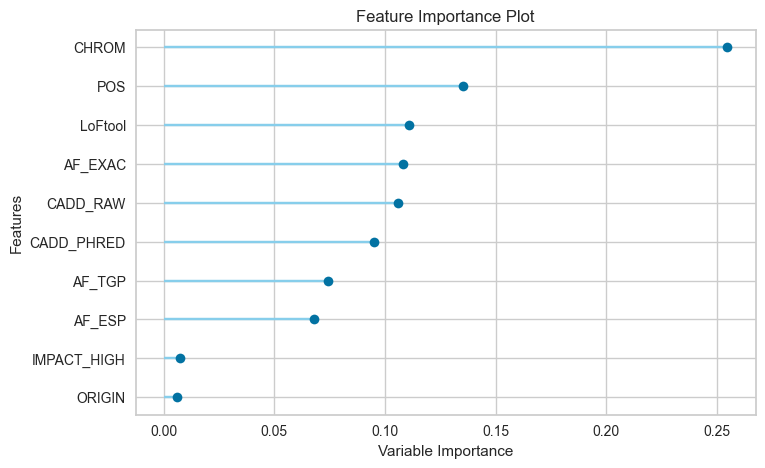

In [95]:
plot_model(rf, plot = 'feature')

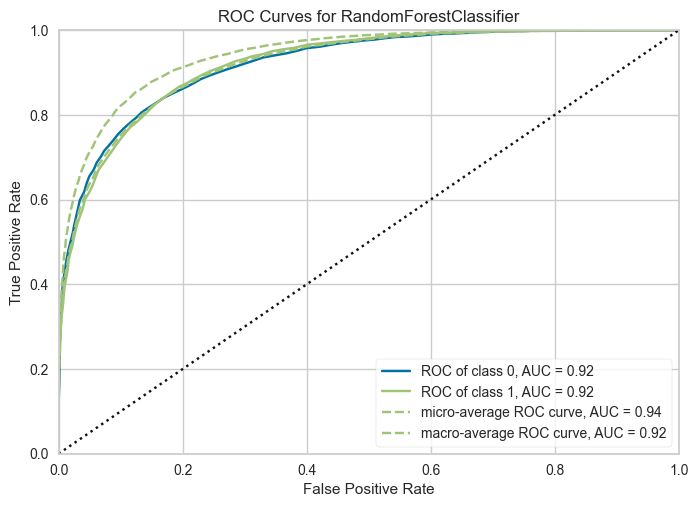

In [83]:

plot_model(rf, plot = 'auc')

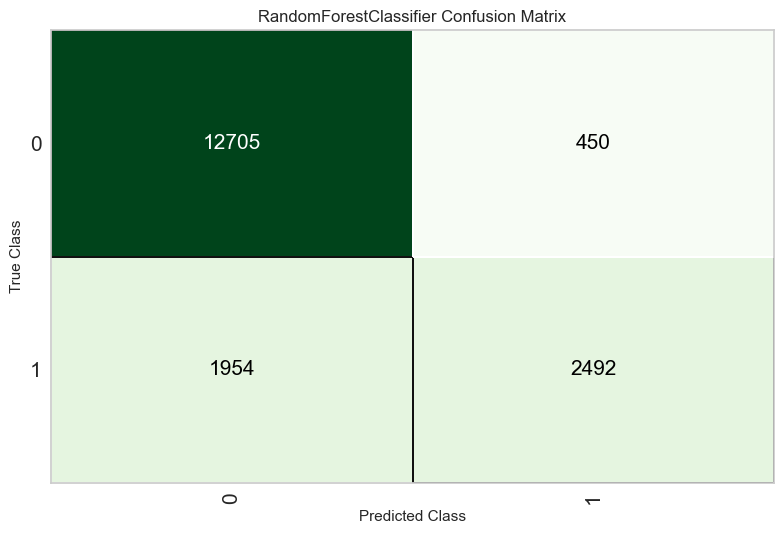

In [84]:
plot_model(rf, plot = 'confusion_matrix')

# Predictions

In [85]:
predict_model(rf)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Random Forest Classifier,0.8634,0.9210,0.5605,0.8470,0.6746,0.5927,0.6129


,POS,AF_ESP,AF_EXAC,AF_TGP,ORIGIN,LoFtool,CADD_PHRED,CADD_RAW,CHROM,IMPACT,Feature_type,BIOTYPE,SIFT,PolyPhen,CLASS,Label,Score
41068,180334623,0.1818,0.17643,0.1314,1,0.51600,12.070000,1.262582,3,LOW,Transcript,protein_coding,deleterious,benign,0,0,1.00
41069,152437986,0.0000,0.06355,0.0320,1,0.99500,0.338000,-0.424090,2,MODIFIER,Transcript,protein_coding,deleterious,benign,0,0,0.96
41070,48033768,0.0000,0.00000,0.0000,1,0.02120,23.000000,3.394929,2,MODERATE,Transcript,protein_coding,deleterious,benign,0,0,1.00
41071,32910630,0.0015,0.00051,0.0024,1,0.08960,13.750000,1.581860,13,MODERATE,Transcript,protein_coding,tolerated,probably_damaging,1,1,0.55
41072,123419687,0.0000,0.00110,0.0014,1,0.73400,11.580000,1.168737,3,LOW,Transcript,protein_coding,deleterious,benign,0,1,0.51
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58664,7567609,0.0000,0.00000,0.0000,1,0.07700,35.000000,7.665156,6,MODERATE,Transcript,protein_coding,deleterious,probably_damaging,0,0,0.80
58665,166201061,0.0000,0.00007,0.0000,1,0.00145,12.680000,1.378657,2,LOW,Transcript,protein_coding,deleterious,benign,1,1,0.81
58666,47705567,0.0000,0.00000,0.0000,1,0.00971,18.170000,2.300516,2,LOW,Transcript,protein_coding,deleterious,benign,0,0,0.90
58667,43067776,0.0004,0.00035,0.0000,1,0.43500,23.799999,4.138664,15,MODERATE,Transcript,protein_coding,deleterious,benign,1,0,0.51


In [89]:
predictions = predict_model(rf, data=data)
predictions.head()

,POS,AF_ESP,AF_EXAC,AF_TGP,ORIGIN,LoFtool,CADD_PHRED,CADD_RAW,CHROM,IMPACT,Feature_type,BIOTYPE,SIFT,PolyPhen,Label,Score
0,48026885,0.0000,0.00000,0.0000,1,0.02120,22.600000,3.163426,2,MODERATE,Transcript,protein_coding,tolerated,possibly_damaging,0,0.99
1,37048524,0.0000,0.00000,0.0000,1,0.00165,11.570000,1.166477,3,LOW,Transcript,protein_coding,deleterious,benign,0,0.93
2,215632255,0.0000,0.00000,0.0000,1,0.85900,15.685616,2.554131,2,MODERATE,Transcript,protein_coding,deleterious,benign,0,0.93
3,29091167,0.0000,0.00001,0.0000,1,0.35600,10.160000,0.913396,22,LOW,Transcript,protein_coding,deleterious,benign,0,0.95
4,152483662,0.0005,0.00041,0.0002,1,0.99500,23.400000,3.808882,2,MODERATE,Transcript,protein_coding,deleterious,benign,0,0.83


In [90]:
predictions = predict_model(rf, data=data, raw_score=True)
predictions.head()

,POS,AF_ESP,AF_EXAC,AF_TGP,ORIGIN,LoFtool,CADD_PHRED,CADD_RAW,CHROM,IMPACT,Feature_type,BIOTYPE,SIFT,PolyPhen,Label,Score_0,Score_1
0,48026885,0.0000,0.00000,0.0000,1,0.02120,22.600000,3.163426,2,MODERATE,Transcript,protein_coding,tolerated,possibly_damaging,0,0.99,0.01
1,37048524,0.0000,0.00000,0.0000,1,0.00165,11.570000,1.166477,3,LOW,Transcript,protein_coding,deleterious,benign,0,0.93,0.07
2,215632255,0.0000,0.00000,0.0000,1,0.85900,15.685616,2.554131,2,MODERATE,Transcript,protein_coding,deleterious,benign,0,0.93,0.07
3,29091167,0.0000,0.00001,0.0000,1,0.35600,10.160000,0.913396,22,LOW,Transcript,protein_coding,deleterious,benign,0,0.95,0.05
4,152483662,0.0005,0.00041,0.0002,1,0.99500,23.400000,3.808882,2,MODERATE,Transcript,protein_coding,deleterious,benign,0,0.83,0.17


In [91]:
unseen_predictions = predict_model(rf, data= data_unseen)
unseen_predictions.head(10)


,POS,AF_ESP,AF_EXAC,AF_TGP,ORIGIN,LoFtool,CADD_PHRED,CADD_RAW,CHROM,IMPACT,Feature_type,BIOTYPE,SIFT,PolyPhen,Label,Score
0,2160554,0.0000,0.00000,0.0000,33,0.345058,23.70,4.079099,1,MODERATE,Transcript,protein_coding,deleterious,benign,0,0.59
1,5935096,0.0032,0.00233,0.0012,1,0.021000,22.20,3.001072,1,MODERATE,Transcript,protein_coding,tolerated,possibly_damaging,0,0.57
2,5940243,0.0159,0.01531,0.0076,1,0.021000,25.30,5.080183,1,MODERATE,Transcript,protein_coding,deleterious,probably_damaging,0,0.73
3,16456763,0.0195,0.01701,0.0078,1,0.473000,35.00,7.786432,1,MODERATE,Transcript,protein_coding,deleterious,possibly_damaging,0,0.63
4,16464489,0.0125,0.02100,0.0186,3,0.473000,11.48,1.149085,1,MODERATE,Transcript,protein_coding,deleterious,benign,0,0.63
5,17349143,0.0000,0.00003,0.0000,1,0.140000,35.00,8.159609,1,MODERATE,Transcript,protein_coding,deleterious,probably_damaging,0,0.83
6,17350523,0.0000,0.00000,0.0000,1,0.140000,33.00,6.952127,1,MODERATE,Transcript,protein_coding,deleterious,probably_damaging,0,0.62
7,17350536,0.0000,0.00000,0.0000,1,0.140000,28.70,6.207139,1,MODERATE,Transcript,protein_coding,deleterious,probably_damaging,0,0.63
8,20977000,0.2700,0.29739,0.3005,1,0.788000,14.40,1.698720,1,MODERATE,Transcript,protein_coding,tolerated,benign,0,0.94
9,21889651,0.0000,0.00000,0.0000,1,0.044700,34.00,7.106938,1,MODERATE,Transcript,protein_coding,deleterious,probably_damaging,0,0.65


# Save the model

In [92]:
save_model(rf, 'my_rf_pipeline')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=Memory(location=C:\Users\91704\AppData\Local\Temp\joblib),
          steps=[('numerical_imputer',
                  TransfomerWrapper(include=['POS', 'AF_ESP', 'AF_EXAC', 'AF_TGP', 'ORIGIN', 'LoFtool', 'CADD_PHRED', 'CADD_RAW'], transformer=SimpleImputer())),
                 ('categorical_imputer',
                  TransfomerWrapper(include=['CHROM', 'IMPACT', 'Feature_type', 'BIOTYPE', 'SIFT', 'PolyPhen'], tr...
                  TransfomerWrapper(include=['IMPACT', 'SIFT', 'PolyPhen'], transformer=OneHotEncoder(cols=['IMPACT', 'SIFT', 'PolyPhen'], handle_missing='return_nan', use_cat_names=True))),
                 ('rest_encoding',
                  TransfomerWrapper(include=['CHROM'], transformer=LeaveOneOutEncoder(cols=['CHROM'], handle_missing='return_nan', random_state=123))),
                 ['trained_model',
                  RandomForestClassifier(n_jobs=-1, random_state=123)]]),
 'my_rf_pipeline.pkl')

In [93]:
loaded_model = load_model('my_rf_pipeline')

Transformation Pipeline and Model Successfully Loaded
